<a href="https://colab.research.google.com/github/carson-edmonds/AAI-510_Life_Expectancy_Prediction/blob/main/Final_Project_Section_3_Team_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Problem Statement
Life insurance is a way to insure someone's life and in the event of a terminal illness or death. The life insurance policy would pay out to the loved ones of the person insured. The insurer has the job of determining the risk the person faces of death and to determine what sort of premium and terms to put in place for that specific policy. The project will thus be aimed at helping to determine key factors that would influence someone's life expectancy that can then be used to predict the risk and life span of future clients. 

Our proposed approach is to use clustering [other model decisions] to determine these key features from WHO life expectancy data.

Dataset: https://www.kaggle.com/datasets/kumarajarshi/life-expectancy-who

## Summary of Features in Dataset
1. **Country:** Country in Alphabetic

2. **Year:**
Year of data collection

3. **Status_Developed:**
1 == Developed Cpuntry, 0 == Developing Country

4. **Life expectancy:**
Life Expectancy in years of age

5. **Adult Mortality:**
Adult Mortality Rates of both sexes (probability of dying between 15 and 60 years per 1000 population)

6. **Infant deaths:**
Number of Infant Deaths per 1000 population

7. **Alcohol:**
Alcohol, recorded per capita (15+) consumption (in litres of pure alcohol)

8. **percentage expenditure:**
Expenditure on health as a percentage of Gross Domestic Product per capita(%)

9. **Hepatitis B:**
Hepatitis B (HepB) immunization coverage among 1-year-olds (%)

10. **Measles:**
Measles - number of reported cases per 1000 population

11. **BMI:**
Average Body Mass Index of entire population

12. **under-five deaths:**
Number of under-five deaths per 1000 population

13. **Polio:**
Polio (Pol3) immunization coverage among 1-year-olds (%)

14. **Total expenditure:**
General government expenditure on health as a percentage of total government expenditure (%)

15. **Diphtheria:**
Diphtheria tetanus toxoid and pertussis (DTP3) immunization coverage among 1-year-olds (%)

16. **HIV/AIDS:**
Deaths per 1 000 live births HIV/AIDS (0-4 years)

17. **GDP:**
Gross Domestic Product per capita (in USD)

18. **Population:**
Population of the Country

19. **thinness 1-19 years:**
Prevalence of thinness among children and adolescents for Age 10 to 19 (% )

20. **thinness 5-9 years:**
Prevalence of thinness among children for Age 5 to 9(%)

21. **Income composition of resources:**
Human Development Index in terms of income composition of resources (index ranging from 0 to 1)

22. **Schooling:**
Number of years of Schooling(years)

In [3]:
#@title Loading the required libraries

import numpy as np # Pandas for array manipulation
import pandas as pd # Pandas for data manipulation
import seaborn as sns # Seaborn for visualizing. Note: we will also use one of the data sets
import matplotlib.pyplot as plt # Matplotlib for subplots
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler # Import for feature standardization
from sklearn.decomposition import PCA # Import for PCA generation
from sklearn.model_selection import train_test_split,  RandomizedSearchCV # Import train_test_split function
from sklearn import metrics # Import scikit-learn metrics module for accuracy calculation
from scipy.stats import randint # Generate random numbers

In [1]:
!pip install dataprep --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 54.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 54.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.6/133.6 kB 13.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 50.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 49.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 84.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 764.0/764.0 kB 52.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 80.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 23.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.6/149.6 kB 14.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
from dataprep.eda import *
from dataprep.datasets import load_dataset
from dataprep.eda import plot, plot_correlation, plot_missing, plot_diff, create_report 

In [4]:
#@title Mounting your Google Drive to Colab

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
#@title Loading data and viewing it

life_df = pd.read_csv('/content/drive/MyDrive/AAI 510/AAI-510 Final Project/Life Expectancy Data.csv')

life_shap = life_df.shape
print("Shape of the dataframe (row, col):",life_shap,"\r\n")

# Show dataframe
life_df

Shape of the dataframe (row, col): (2938, 22) 



,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,Zimbabwe,2004,Developing,44.3,723.0,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2934,Zimbabwe,2003,Developing,44.5,715.0,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2935,Zimbabwe,2002,Developing,44.8,73.0,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2936,Zimbabwe,2001,Developing,45.3,686.0,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


In [6]:
#@title Encoding data for processing
#Encoding Name contract type using get_dummies
life_df = pd.get_dummies(life_df, columns=['Status'], drop_first=True)

In [7]:
life_df['Country'] = life_df['Country'].astype('category')
life_df['Country'] = life_df['Country'].cat.codes
life_df

,Country,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,...,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling,Status_Developing
0,0,2015,65.0,263.0,62,0.01,71.279624,65.0,1154,19.1,...,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1,1
1,0,2014,59.9,271.0,64,0.01,73.523582,62.0,492,18.6,...,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0,1
2,0,2013,59.9,268.0,66,0.01,73.219243,64.0,430,18.1,...,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9,1
3,0,2012,59.5,272.0,69,0.01,78.184215,67.0,2787,17.6,...,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8,1
4,0,2011,59.2,275.0,71,0.01,7.097109,68.0,3013,17.2,...,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,192,2004,44.3,723.0,27,4.36,0.000000,68.0,31,27.1,...,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2,1
2934,192,2003,44.5,715.0,26,4.06,0.000000,7.0,998,26.7,...,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5,1
2935,192,2002,44.8,73.0,25,4.43,0.000000,73.0,304,26.3,...,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0,1
2936,192,2001,45.3,686.0,25,1.72,0.000000,76.0,529,25.9,...,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8,1


In [24]:
#@title Renaming columns to remove extra whitespace
life_df.rename(columns = {'Life expectancy ':'Life expectancy', ' BMI ':'BMI', 'Diphtheria ':'Diphtheria', ' thinness  1-19 years':'thinness 1-19 years', ' thinness 5-9 years':'thinness 5-9 years'}, inplace = True)

In [25]:
#@title Handling Null Values
# Note: If Country and Status columns had null values we would want to replace them before encoding.
#print(life_df.isnull().sum())
life_df['Life expectancy'] = life_df['Life expectancy'].fillna(life_df['Life expectancy'].mean())
life_df['Adult Mortality'] = life_df['Adult Mortality'].fillna(life_df['Adult Mortality'].mean())
life_df['Alcohol'] = life_df['Alcohol'].fillna(life_df['Alcohol'].mean())
life_df['Hepatitis B'] = life_df['Hepatitis B'].fillna(life_df['Hepatitis B'].mean())

life_df['BMI'] = life_df['BMI'].fillna(life_df['BMI'].mean())
life_df['Polio'] = life_df['Polio'].fillna(life_df['Polio'].mean())
life_df['Total expenditure'] = life_df['Total expenditure'].fillna(life_df['Total expenditure'].mean())
life_df['Diphtheria'] = life_df['Diphtheria'].fillna(life_df['Diphtheria'].mean())

life_df['GDP'] = life_df['GDP'].fillna(life_df['GDP'].mean())
life_df['Population'] = life_df['Population'].fillna(life_df['Population'].mean())
life_df['thinness 1-19 years'] = life_df['thinness 1-19 years'].fillna(life_df['thinness 1-19 years'].mean())
life_df['thinness 5-9 years'] = life_df['thinness 5-9 years'].fillna(life_df['thinness 5-9 years'].mean())

life_df['Income composition of resources'] = life_df['Income composition of resources'].fillna(life_df['Income composition of resources'].mean())
life_df['Schooling'] = life_df['Schooling'].fillna(life_df['Schooling'].mean())

#print(life_df.isnull().sum())


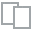
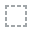
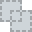
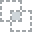
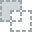
...
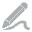
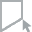
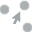
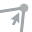
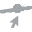

In [10]:
#@title Correlation Overview of Data
plot_correlation(life_df)


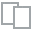
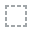
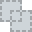
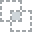
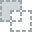
...
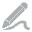
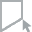
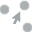
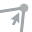
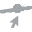

In [26]:
#@markdown ###Correlation plot comparing all features to target life expectancy.
plot_correlation(life_df, "Life expectancy")


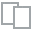
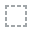
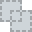
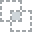
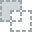
...
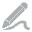
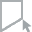
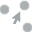
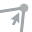
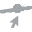

In [27]:
#@title Life expectancy stats
plot(life_df, "Life expectancy")


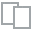
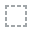
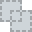
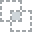
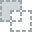
...
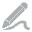
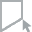
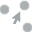
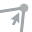
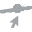

In [13]:
#@title Developing and Developed Country Stats
plot(life_df, "Status_Developing")

## Visualizing relationships between life expectancy and other features

/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:6751: FutureWarning: Meta is not valid, `map_partitions` and `map_overlap` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(



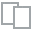
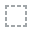
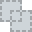
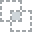
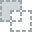
...
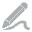
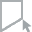
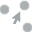
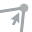
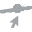

In [28]:
#@title Total Expenditure versus Life expectancy
plot(life_df, "Total expenditure", "Life expectancy")

/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:6751: FutureWarning: Meta is not valid, `map_partitions` and `map_overlap` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:6751: FutureWarning: Meta is not valid, `map_partitions` and `map_overlap` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(



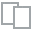
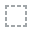
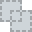
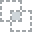
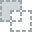
...
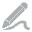
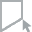
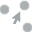
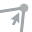
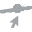

In [29]:
#@title Status Developing versus Life expectancy
plot(life_df, "Status_Developing", "Life expectancy")

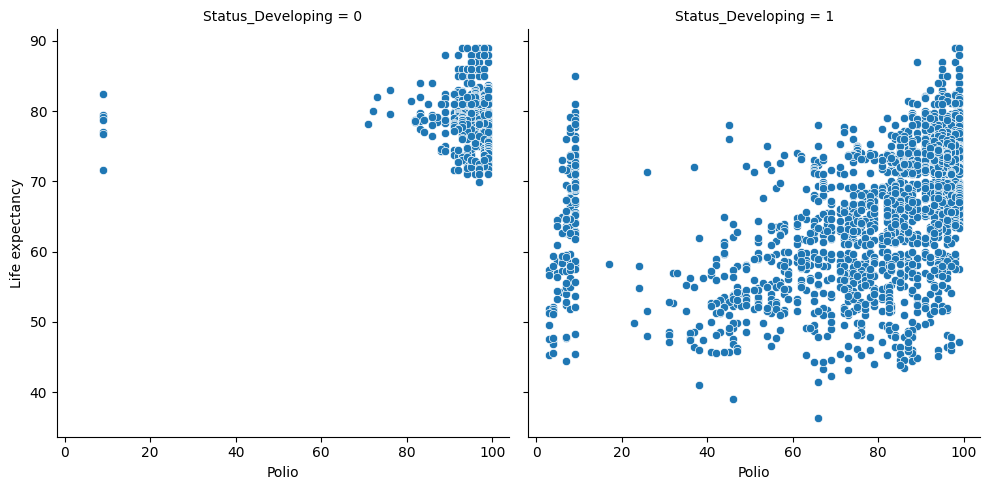

In [30]:
#@title Relationship between polio vaccine and life expectancy seperated by developing status
# Create a visualization
sns.relplot(
    data=life_df,
    x="Polio", y="Life expectancy", col="Status_Developing",
)

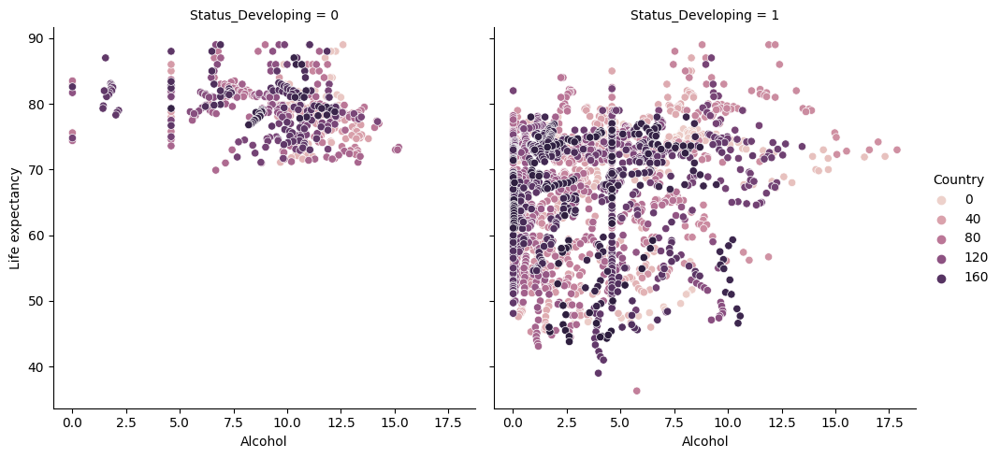

In [31]:
sns.relplot(
    data=life_df,
    x="Alcohol", y="Life expectancy", col="Status_Developing", hue="Country"
)

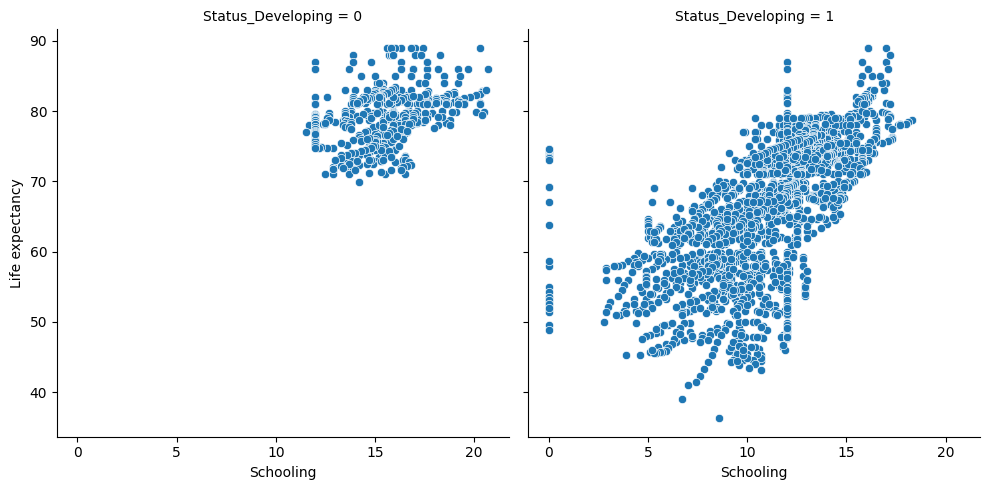

In [32]:
sns.relplot(
    data=life_df,
    x="Schooling", y="Life expectancy", col="Status_Developing",
)

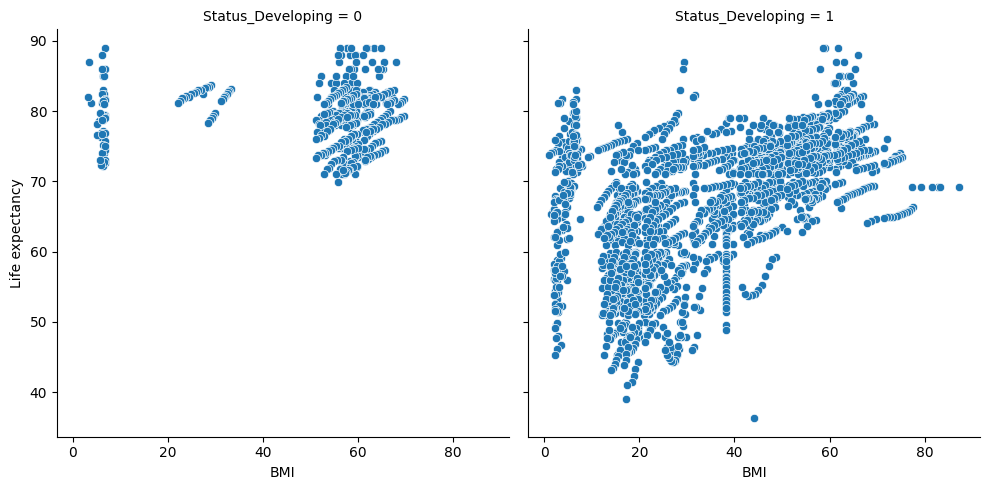

In [33]:
sns.relplot(
    data=life_df,
    x="BMI", y="Life expectancy", col="Status_Developing",
)

DataPrep Report
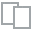
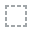
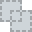
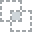
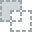
...
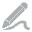
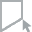
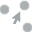
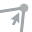
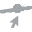

In [34]:
create_report(life_df)